# Small overview of PyViz capability of data exploration

<style>div.container { width: 100% }</style>
<img style="float:left;  vertical-align:text-bottom;" height="65" width="172" src="https://raw.githubusercontent.com/pyviz/holoviz/4f1bba2027928db37fb6337fe556bc156edf9908/examples/assets/PyViz_logo_wm_line.png" />
<div style="float:right; vertical-align:text-bottom;"></div>

This notebook is intended to present a small overview of PyViz and the capability for data exploration, with interactive plots (show difference between matplotlib and bokeh). Many parts are based on or copied from the official [PyViz Tutorial](https://holoviz.org/tutorial/index.html) (highly recommended for a more extensive overview of the possibilities of PyViz).

## PyViz Packages used for this notebook
<br>
<table>
<tr>
    <td><img src="https://raw.githubusercontent.com/pyviz/holoviz/master/examples/assets/hvplot.png" width=90px style="margin: 0px 25%"></td>
    <td><img src="https://raw.githubusercontent.com/pyviz/holoviz/master/examples/assets/bokeh.png"  width=100px style="margin: 0px 25%"></td>
    <td><img src="https://raw.githubusercontent.com/pyviz/holoviz/master/examples/assets/holoviews.png"  width=130px style="margin: 0px 25%"></td>
    <td><img src="https://raw.githubusercontent.com/pyviz/holoviz/master/examples/assets/geoviews.png"  width=130px style="margin: 0px 25%"></td>
</tr>
</table>

## Exploring Pandas Dataframes

If your data is in a Pandas dataframe, it's natural to explore it using the ``.plot()`` method (based on Matplotlib). Let's have a look at some automatic weather station data from Langenferner:

In [1]:
import pandas as pd
url = 'https://cluster.klima.uni-bremen.de/~oggm/tutorials/aws_data_Langenferner_UTC+2.csv'
df = pd.read_csv(url, index_col=0, parse_dates=True)
df.head()

,TEMP,RH,SWIN,SWOUT,LWIN,LWOUT,WINDSPEED,WINDDIR,PRESSURE
2013-07-13 00:00:00,1.634333,67.595753,0.0,0.0,212.744817,303.656833,4.436833,211.533333,692.622250
2013-07-13 01:00:00,1.388667,68.150512,0.0,0.0,209.781683,302.588717,5.544000,206.166667,692.395683
2013-07-13 02:00:00,1.064500,66.853977,0.0,0.0,207.234933,300.872133,5.573167,210.750000,692.200800
2013-07-13 03:00:00,0.985167,55.827547,0.0,0.0,207.913533,295.684267,3.970167,203.250000,692.163967
2013-07-13 04:00:00,1.155333,43.371014,0.0,0.0,211.513517,292.688400,3.267000,203.366667,692.001667


Just calling ``.plot()`` won't give anything meaningful, because of the different magnitudes of the parameters:

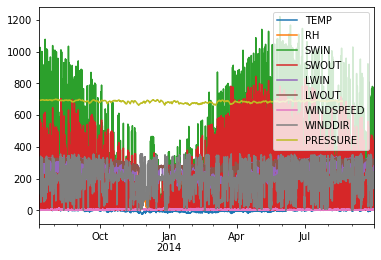

In [3]:
df.plot();

Of course we can have a look at one variable only:

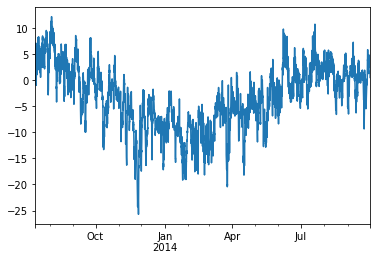

In [4]:
df.TEMP.plot();

This creates a static plot using matplotlib. With this approach we also can make some further explorations, like calculating the monthly mean temperature:

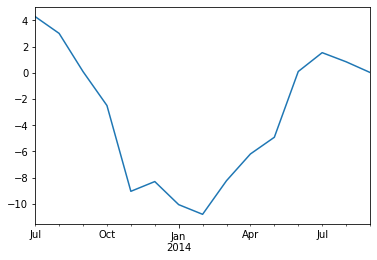

In [5]:
dfm = df.resample('m').mean()
dfm.TEMP.plot();

We can see the course of the parameter but we can not tell what was the exact temperature at January and we also cannot zoom in.

## Exploring Data with hvPlot and Bokeh

If we are using ```hvplot``` instead we can create interactive plots with the same plotting API:

you might need to install first [hvplot](https://hvplot.holoviz.org/getting_started/index.html) via e.g. conda install -c pyviz hvplot

In [6]:
import hvplot.pandas

df.TEMP.hvplot()

:Curve   [index]   (TEMP)

Now you have an interactive plot using bokeh with zooming option and hover with additional information (get the exact values and timestamps), also possible for all variables but again not very meaningful:

In [7]:
plot = df.hvplot()
plot

:NdOverlay   [Variable]
   :Curve   [index]   (value)

But at least you can use your mouse to hover over each variable and explore their values. Furthermore, by clicking on the legend the colors can be switched on/off. Still, different magnitudes make it hard to see all parameters at once.

Here the interactive features are provided by the [Bokeh](http://bokeh.pydata.org) JavaScript-based plotting library. But what's actually returned by this call is a overlay of something called a [HoloViews](http://holoviews.org) object, here specifically a HoloViews [Curve](http://holoviews.org/reference/elements/bokeh/Curve.html).  HoloViews objects *display* as a Bokeh plot, but they are actually much richer objects that make it easy to capture your understanding as you explore the data.

In [8]:
print(plot)

:NdOverlay   [Variable]
   :Curve   [index]   (value)


This object can be converted to a `HoloMap` object (using the HoloViews Package and declare bokeh to use for plotting) to create a widget that can be used to select the variables from.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
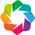

In [9]:
import holoviews as hv
hv.extension('bokeh')

In [10]:
holo_plot = hv.HoloMap(plot)
print(holo_plot)

:HoloMap   [Variable]
   :Curve   [index]   (value)


In [11]:
holo_plot.opts(width=700, height=500)

:HoloMap   [Variable]
   :Curve   [index]   (value)

But first have a look at the HoloViews Objects.

## HoloViews Objects

Creating a simple HoloViews Object:

In [12]:
import numpy as np

In [13]:
xs = np.arange(-10, 10.5, 0.5)
ys = 100 - xs**2
df_xy = pd.DataFrame(dict(x=xs, y=ys))

simple_curve = hv.Curve(df_xy, 'x', 'y')
print(simple_curve)

:Curve   [x]   (y)


``:Curve [x] (y)`` is HoloViews's shorthand for saying that the data in ``df_xy`` is a set of samples from a continuous function ``y`` of one independent variable ``x``, and ``simple_curve`` simply pairs your dataframe ``df_xy`` with this semantic declaration.

Once we've captured this crucial bit of metadata, HoloViews now knows enough about this object to represent it graphically, as it will do by default in a Jupyter notebook:

In [14]:
simple_curve

:Curve   [x]   (y)

This Bokeh plot is much more convenient to examine than a column of numbers, because it conveys the entire set of data in a compact, easily appreciated, interactively explorable format.  HoloViews knew that a continuous curve like this is the right representation for what would otherwise be just a table of numbers, because we explicitly declared the element type as ``hv.Curve``. Crucially, ``simple_curve`` itself is not a plot, it's just a simple wrapper around your data that happens to have a convenient graphical representation. The full dataframe will always be available as  ``simple_curve.data``, for any numerical computations you would like to do:

In [15]:
simple_curve.data.tail()

,x,y
36,8.0,36.00
37,8.5,27.75
38,9.0,19.00
39,9.5,9.75
40,10.0,0.00


As you can see, with HoloViews you don't have to select between plotting your data and working with it numerically. Any HoloViews object will let you do *both* conveniently; you can simply choose whatever representation is the most appropriate way to approach the task you are doing.  This approach is very different from a traditional plotting program, where the objects you create (e.g. a Matplotlib figure or a native Bokeh plot) are a dead end from an analysis perspective, useful only for plotting.  
### HoloViews Elements

Holoview objects merge the visualization with the data. For an Holoview object you have to classify what the data is showing. A Holoview object could be initialised in several ways: 

```
hv.Element(data, kdims=None, vdims=None, **kwargs)
```

This standard signature consists of the same five types of information:

- **``Element``**: any of the dozens of element types shown in the [reference gallery](http://holoviews.org/reference/index.html).
- **``data``**: your data in one of a number of formats described below, such as tabular dataframes or multidimensional gridded Xarray or Numpy arrays.
- **``kdims``**: "key dimension(s)", also called independent variables or index dimensions in other contexts---the values for which your data was measured.
- **``vdims``**: "value dimension(s)", also called dependent variables or measurements---what was measured or recorded for each value of the key dimensions. 
- **``kwargs``**: optional keyword arguments specific to that ``Element`` type (rarely needed).

Elements could be for example ```Curve```, ``` Scatter```, ```Area``` and also different ways of declaring the key dimension(s) and value dimension(s) are shown below:

In [16]:
(hv.Curve(df_xy, kdims=('x','x_label'), vdims=('y','y_label'))  +  
 hv.Scatter((xs,ys)).redim.label(x='x_label', y='ylabel')  +  
 hv.Area({'x':xs,'y':ys}))

:Layout
   .Curve.I   :Curve   [x]   (y)
   .Scatter.I :Scatter   [x]   (y)
   .Area.I    :Area   [x]   (y)

The example also shows two ways of labeling the variables, one is directly by the initialisation with tuples ```('x','x_label')``` and ```('y','y_label')``` and a other option is to use ```.redim.label()```.

The example above also shows the simple syntax to create a layout of different Holoview Objects by using `+`. With `*` you can simply overlay the objects in one plot:

In [17]:
from holoviews import opts

(hv.Curve(df_xy, 'x', 'y') * 
 hv.VLine(5).opts(color='black') * 
 hv.HLine(75).opts(color='red'))

:Overlay
   .Curve.I :Curve   [x]   (y)
   .VLine.I :VLine   [x,y]
   .HLine.I :HLine   [x,y]

With ```.opts()``` you can change some characteristics of the Holoview Objects and you can use the `[tab]` key completion to see, what options are available or you can use the ```hv.help()``` function to get more information about some `Elements`.

In [18]:
# hv.help(hv.Curve)

Curve

Online example: http://holoviews.org/reference/elements/bokeh/Curve.html

-------------
Style Options
-------------

	alpha, color, hover_alpha, hover_color, hover_line_alpha, hover_line_color, line_alpha, line_cap, line_color, line_dash, line_join, line_width, muted, muted_alpha, muted_color, muted_line_alpha, muted_line_color, nonselection_alpha, nonselection_color, nonselection_line_alpha, nonselection_line_color, selection_alpha, selection_color, selection_line_alpha, selection_line_color, visible

(Consult bokeh's documentation for more information.)

------------
Plot Options
------------

The plot options are the parameters of the plotting class:

Parameters of 'CurvePlot'

Parameters changed from their default values are marked in red.
Soft bound values are marked in cyan.
C/V= Constant/Variable, RO/RW = ReadOnly/ReadWrite, AN=Allow None

Name                                 Value                         Type         Bounds     Mode  

active_tools                       

So now we can use some Holoview object for the data exploration for the glacier data. We create a `Layout` with some subplots for the different parameters. With ```opts.defaults()``` we can change some default properties of the different HoloView Elements, here we activate the ```hover``` tool for all ```Curve``` elements. Try to zoom into one plot!

In [19]:
opts.defaults(opts.Curve(tools=['hover']))

(hv.Curve(df, 'index', 'TEMP') + 
 hv.Curve(df,'index','RH') + 
 hv.Curve(df,'index','SWIN').opts(color='darkorange') * hv.Curve(df,'index','SWOUT').opts(color='red') +
 hv.Curve(df,'index','LWIN').opts(color='darkorange') * hv.Curve(df,'index','LWOUT').opts(color='red') +
 hv.Curve(df,'index','WINDSPEED') + 
 hv.Curve(df,'index','WINDDIR')).cols(3).opts(opts.Curve(width=300, height=200))

:Layout
   .Curve.I    :Curve   [index]   (TEMP)
   .Curve.II   :Curve   [index]   (RH)
   .Overlay.I  :Overlay
      .Curve.I  :Curve   [index]   (SWIN)
      .Curve.II :Curve   [index]   (SWOUT)
   .Overlay.II :Overlay
      .Curve.I  :Curve   [index]   (LWIN)
      .Curve.II :Curve   [index]   (LWOUT)
   .Curve.III  :Curve   [index]   (WINDSPEED)
   .Curve.IV   :Curve   [index]   (WINDDIR)

So here we created a ```Curve``` Element for some Parameters and put them together in subplots by using `+` and overlay some in one subplot with `*`. With ```.opts()``` I define the color of some parameters and set the ```width``` and ```height``` propertie for the used ```Curve``` Elements and with ```.cols()``` I define the number of columns. 

Now we can zoom in and use a hover for data exploration and because all Holoview Objects using the same dataframe and the same key variable the x-axes of all plots are linked. So when you zoom in in one plot all the other plots are zoomed in as well.

### HoloView Dataset and HoloMap Objects

A HoloViews `Dataset` is similar to a HoloViews Element, without having any specific metadata that lets it visualize itself. A Dataset is useful for specifying a set of `Dimension`s that apply to the data, which will later be inherited by any visualizable elements that you create from the Dataset.

A HoloViews Dimension is the same concept as a **dependent** or **independent** variable in mathematics. In HoloViews such variables are called value dimensions and key dimensions (respectively). So lets take again our glacier pandas DataFrame and create a HoloView `Dataset`. Beforehand we define some new columns for the date. Then we create our HoloView DataFrame with the key variables (independent) ``month``, ``year`` and ``day_hour``. The remaining columns will automatically be inferred to be value (dependent) dimensions:

In [20]:
df['month'] = df.index.month
df['year'] = df.index.year
df['day_hour'] = df.index.day + df.index.hour/24
df['timestamp'] = df.index.strftime('%d.%m.%Y %H:%M')

df_month = hv.Dataset(df, ['month', 'year', 'day_hour'])
df_month = df_month.redim.label(day_hour='day of month')
df_month

:Dataset   [month,year,day_hour]   (TEMP,RH,SWIN,SWOUT,LWIN,LWOUT,WINDSPEED,WINDDIR,PRESSURE,timestamp)

Out of this Dataset we now can create a `Holomap` with ``.to``. The ``.to`` method of a Dataset takes up to four main arguments:

1. The element you want to convert to
2. The key dimensions (i.e., independent variables) to display
3. The dependent variables to display, if any
4. The dimensions to group by, if nothing given the remaining key variables are used

In [21]:
slider = df_month.to(hv.Curve, ['day_hour'], ['TEMP', 'RH', 'SWIN', 'timestamp'])
slider = slider.opts(width=600, height=400, tools=['hover'])
print(slider)

:HoloMap   [month,year]
   :Curve   [day_hour]   (TEMP,RH,SWIN,timestamp)


We now created a ``HoloMap`` with to grouped variables ``[month, year]``, one key variable ``[day_hour]`` and five dependent variables ``(TEMP, RH, SWIN, WINDSPEED, timestamp)``. Now look at the visualisation (some months/year pairs are missing and cannot be visualized):

In [22]:
slider

:HoloMap   [month,year]
   :Curve   [day_hour]   (TEMP,RH,SWIN,timestamp)

We see that a widget was created where we can choose the ``'month'`` and the ``'year'`` (the two grouped variables). The plot is showing the `'day_hour'` (key) variable against the first dependent variable ``'TEMP'``. The other dependent variables are not shown but their values are displayed in the hover.

For a better comparison we also can look at grouped variables at once when we use ``.overlay()``:

In [23]:
overlay = df_month.to(hv.Curve, ['day_hour'], ['TEMP', 'RH', 'SWIN','WINDSPEED','timestamp']).overlay()
overlay = overlay.opts(width=800, height=500, tools=['hover'])
overlay.opts(opts.NdOverlay(legend_muted=True, legend_position='left'))
print(overlay)

:NdOverlay   [month,year]
   :Curve   [day_hour]   (TEMP,RH,SWIN,WINDSPEED,timestamp)


Here we are creating an ``NdOverlay`` Object which is similar to a ``HoloMap``, but has a different visualisation:

In [24]:
overlay

:NdOverlay   [month,year]
   :Curve   [day_hour]   (TEMP,RH,SWIN,WINDSPEED,timestamp)

Here now no widget is created, instead there is a interactive legend where we can turn the color *on* by clicking in the legend on it. So we can compare the months with each other (for example the same month in different years).

It is also easy to look at some mean values, for example looking at mean diurnal values for each month and year you can use ```.aggregate```, which combine the values after the given function:

In [25]:
df['hour'] = df.index.hour
df_mean = hv.Dataset(df, ['month', 'year', 'hour']).aggregate(function=np.mean)
df_mean = df_mean.redim.label(hour='hour of the day')
print(df_mean)

:Dataset   [month,year,hour]   (TEMP,RH,SWIN,SWOUT,LWIN,LWOUT,WINDSPEED,WINDDIR,PRESSURE,day_hour)


```.aggregate()``` uses the key variables and looks where all of them are the same. It uses the provided function (in the case above ```np.mean```) to calculate new values. So in the above case we calculate mean daily cycles for each month and year. The calculated ``Dataset`` then can be displayed as we have seen it above.

In [26]:
slider = df_mean.to(hv.Curve, ['hour'], ['TEMP', 'RH', 'SWIN']).opts(width=600, height=400, tools=['hover'])
print(slider)
slider

:HoloMap   [month,year]
   :Curve   [hour]   (TEMP,RH,SWIN)


:HoloMap   [month,year]
   :Curve   [hour]   (TEMP,RH,SWIN)

In [27]:
overlay = df_mean.to(hv.Curve, ['hour'], ['TEMP', 'RH', 'SWIN']).opts(width=600, height=400, tools=['hover']).overlay()
overlay.opts( opts.NdOverlay(legend_muted=True, legend_position='left'))
print(overlay)
overlay

:NdOverlay   [month,year]
   :Curve   [hour]   (TEMP,RH,SWIN)


:NdOverlay   [month,year]
   :Curve   [hour]   (TEMP,RH,SWIN)

## Using GeoView for displaying geographical data

As a small example for using geoview I want to show how to display a shapefiles of glaciers in an interactive plot.

In [28]:
import geoviews as gv
import geopandas as gpd

you might have to install [geoviews](https://geoviews.org/index.html#installation) for that!

### Tile sources

Tile sources are very convenient ways to provide geographic context for a plot and they will be familiar from the popular mapping services like Google Maps and Openstreetmap. The ``WMTS`` element provides an easy way to include such a tile source in your visualization simply by passing it a valid URL template. GeoViews provides a number of useful tile sources in the ``gv.tile_sources`` module:

In [29]:
import geoviews.tile_sources as gts

layout = gv.Layout([ts.relabel(name) for name, ts in gts.tile_sources.items()])
layout.opts('WMTS', xaxis=None, yaxis=None, width=225, height=225).cols(4)

:Layout
   .WMTS.CartoDark             :WMTS   [Longitude,Latitude]
   .WMTS.CartoEco              :WMTS   [Longitude,Latitude]
   .WMTS.CartoLight            :WMTS   [Longitude,Latitude]
   .WMTS.CartoMidnight         :WMTS   [Longitude,Latitude]
   .WMTS.StamenTerrain         :WMTS   [Longitude,Latitude]
   .WMTS.StamenTerrainRetina   :WMTS   [Longitude,Latitude]
   .WMTS.StamenWatercolor      :WMTS   [Longitude,Latitude]
   .WMTS.StamenToner           :WMTS   [Longitude,Latitude]
   .WMTS.StamenTonerBackground :WMTS   [Longitude,Latitude]
   .WMTS.StamenLabels          :WMTS   [Longitude,Latitude]
   .WMTS.EsriImagery           :WMTS   [Longitude,Latitude]
   .WMTS.EsriNatGeo            :WMTS   [Longitude,Latitude]
   .WMTS.EsriUSATopo           :WMTS   [Longitude,Latitude]
   .WMTS.EsriTerrain           :WMTS   [Longitude,Latitude]
   .WMTS.EsriReference         :WMTS   [Longitude,Latitude]
   .WMTS.EsriOceanBase         :WMTS   [Longitude,Latitude]
   .WMTS.EsriOceanReference    :WMTS   [Longitude,Latitude]
   .WMTS.OSM                   :WMTS   [Longitude,Latitude]
   .WMTS.Wikipedia             :WMTS   [Longitude,Latitude]

To read the shape file geopandas could be used:

In [30]:
from oggm import utils
europe_glacier = gpd.read_file(utils.get_rgi_region_file('11', version='61'))
hintereisferner = europe_glacier[europe_glacier.Name == 'Hintereisferner'].geometry.iloc[0]

Then create a GeoViews Object with a GeoViews Element Shape, display it and put a ``gv.tile_sources`` in the background.  

In [31]:
# hv.help(gv.Shape)

Shape

Help for the data object: holoviews.help(Shape) or holoviews.help(<shape_instance>)

-------------
Style Options
-------------

	alpha, cmap, color, fill_alpha, fill_color, hover_alpha, hover_color, hover_fill_alpha, hover_fill_color, hover_line_alpha, hover_line_color, line_alpha, line_cap, line_color, line_dash, line_join, line_width, muted, muted_alpha, muted_color, muted_fill_alpha, muted_fill_color, muted_line_alpha, muted_line_color, nonselection_alpha, nonselection_color, nonselection_fill_alpha, nonselection_fill_color, nonselection_line_alpha, nonselection_line_color, selection_alpha, selection_color, selection_fill_alpha, selection_fill_color, selection_line_alpha, selection_line_color, visible

(Consult bokeh's documentation for more information.)

------------
Plot Options
------------

The plot options are the parameters of the plotting class:

Parameters of 'GeoShapePlot'

Parameters changed from their default values are marked in red.
Soft bound values are marked 

In [32]:
(gv.Shape(hintereisferner).opts(fill_color=None) *
 gts.tile_sources['EsriImagery']).opts(width=800, height=500)

:Overlay
   .Shape.I :Shape   [Longitude,Latitude]
   .WMTS.I  :WMTS   [Longitude,Latitude]

The GeoViews Object and Element is similar to HoloViews Objects and Elements for geographical data. 

In [33]:
print(gv.Shape(hintereisferner))

:Shape   [Longitude,Latitude]


And so similar a visualisation is stored for each GeoView Element, which can be used like an HoloView Object. So as a last example you also can plot all European glaciers in one interactive plot by using an Polygons Element of GeoViews:

In [34]:
(gv.Polygons(europe_glacier)*
 gts.tile_sources['StamenTerrain']).opts(width=800, height=500)

:Overlay
   .Polygons.I :Polygons   [Longitude,Latitude]
   .WMTS.I     :WMTS   [Longitude,Latitude]

So this only was a very small look at the capability of PyViz for data exploration and visualisation. There are much more you can do with PyViz, but I think it is a package you should have a look at, because with only a few lines of code you can create an interactive plot which allow you to have an quick but also deep look at your data. I really recommend to visit the official [PyViz Tutorial](https://holoviz.org/tutorial/index.html) and start using PyViz :)

## What's next?

- return to the [OGGM documentation](https://docs.oggm.org)
- back to the [table of contents](welcome.ipynb)